In [1]:
import numpy as np
import pandas as pd
import nipy
from nipy.modalities.fmri import hrf, utils
from pprint import pprint
import os
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as tkr     # has classes for tick-locating and -formatting
%matplotlib inline

def numfmt(x, pos): # your custom formatter function: divide by 100.0
    s = '{}'.format(x / 10.0)
    return s

### Model BOLD-response using glover
function taken from nipy

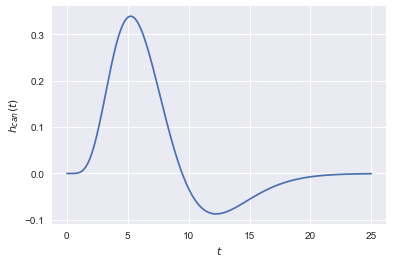

In [2]:
# hrf.glover is a symbolic function; get a function of time to work on arrays
hrf_func = utils.lambdify_t(hrf.glover(utils.T))

# Time array
t = np.linspace(0,25,200)

# plot BOLD as function of time
plt.plot(t, hrf_func(t))
a=plt.gca()
a.set_xlabel(r'$t$')
a.set_ylabel(r'$h_{can}(t)$')

## Function to create EV matrix for a single participant
The EV matrix is of size (n_deciseconds, n_evs). The columns are boxcar functions of the events
The returned matrix X is of size (n_deciseconds, n_evs), and is the EV matrix convolved with the HRF

In [15]:
def stim_to_design(pp_design, block=None):
    
    # Check if we only need to do a subset of the design
    if block is not None:
        pp_design = pp_design.loc[pp_design['block'] == block]
    
    # Get rid of null trials
    pp_design = pp_design.loc[pp_design['null_trial'] == False,:]

    # hrf.glover is a symbolic function; get a function of time to work on arrays
    hrf_func = utils.lambdify_t(hrf.glover(utils.T))
    
    n_conditions = len(np.unique(pp_design['cue']))
    max_time = np.ceil((pp_design['stimulus_onset_time'].max()+25)*10)

    if 0 in pp_design['block'].unique():
        block0_trials = pp_design.loc[pp_design['block'] == 0]
        # Get cue-types and response types for the first block
        loc_cue_vec = np.zeros(shape=(int(max_time), 4))
        response_vec = np.zeros(shape=(int(max_time), 4))
        loc_cue_names = []
        response_names = []

        i = -1
        for effector_type in block0_trials['response_modality'].unique():
            for cue_type in block0_trials['cue'].unique():
                
                subset = pp_design.loc[(pp_design['block'] == 0 ) &
                                       (pp_design['response_modality'] == effector_type) &
                                       (pp_design['cue'] == cue_type)]
                i += 1
                response_names.append('resp_%s_%s' % (effector_type, cue_type))
                loc_cue_names.append('cue_%s_%s' % (effector_type, cue_type))

                # Get cue onsets & durations
                onsets = subset['cue_onset_time'].values*10
                durations = subset['phase_2'].values*10
                for onset, duration in zip(onsets, durations):
                    loc_cue_vec[np.arange(onset, onset+duration, dtype='int'), i] = 1

                # Get response onsets & durations
                onsets = subset['stimulus_onset_time'].values*10
                durations = subset['phase_4'].values*10
                for onset, duration in zip(onsets, durations):
                    response_vec[np.arange(onset, onset+duration, dtype='int'), i] = 1
        
        # For all further EVs, make sure not to include the localizer trials.
        pp_design = pp_design.loc[pp_design['block'] > 0]

    # 10 types of stimuli
    stim_vec = np.zeros(shape=(int(max_time), 10))
    stim_names = []
    
    # Get stimulus onsets and durations
    i = -1
    for stim_type in pp_design['correct_answer'].unique():
        
        for cue_type in pp_design['cue'].unique():
            i += 1
            stim_names.append('stimulus_' + str(int(stim_type)) + '_' + cue_type)
            subset = pp_design.loc[(pp_design['correct_answer'] == stim_type) &
                                   (pp_design['cue'] == cue_type)]
            stim_onsets = subset['stimulus_onset_time'].values*10
            stim_durations = subset['phase_4'].values*10

            for onset, duration in zip(stim_onsets, stim_durations):
                stim_vec[np.arange(onset, onset+duration, dtype='int'), i] = 1
    
    # Get cue onsets by cue type
    cue_names = []
    cue_vec = np.zeros(shape=(int(max_time), n_conditions))  # A column per cue type condition
    i = -1
    for condition in pp_design['cue'].unique():
        i += 1
        cue_names.append('cue_' + condition)

        # Find cue onsets
        onsets = pp_design.loc[pp_design['cue'] == condition, 'cue_onset_time'].values*10
        durations = pp_design.loc[pp_design['cue'] == condition, 'phase_2'].values*10
        for onset, duration in zip(onsets, durations):
            cue_vec[np.arange(onset, onset+duration, dtype='int'), i] = 1
    
    # Combine everything in a single array
    ev_vec = np.hstack((loc_cue_vec, response_vec, cue_vec, stim_vec))
    ev_names = loc_cue_names + response_names + cue_names + stim_names
            
    # Create hrf to convolve with
    hrf_full = hrf_func(np.linspace(0, stop=int(max_time/10), num=int(max_time)))

    # Pre-allocate output. This will be an n_timepoints x n_conditions+1 matrix.
    X = np.empty(shape=(int(max_time), ev_vec.shape[1]))

    # Convolve everything: the stimulus first, the cues afterwards.
    for i, ev_name in enumerate(ev_names):
        print('Convolving %s...' % ev_name)
        X[:, i] = np.convolve(hrf_full, ev_vec[:, i])[:int(max_time)]
            
    return X, ev_names

## Function to plot an individual participant's design

In [16]:
def plot_participant_design(pp_design, pp_num, block=None, X=None, ev_names=None, null_onsets=None):

    if X is None:
        X, ev_names = stim_to_design(pp_design, block)
    n_evs = len(ev_names)
    print(ev_names)
    X = pd.DataFrame(X, columns=ev_names)
    plot_order = ['cue_eye_LEFT', 'cue_eye_RIGHT', 'cue_hand_LEFT', 'cue_hand_RIGHT',
                  'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT',
                  'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 
                  'stimulus_0_SPD', 'stimulus_0_ACC',
                  'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT',
                  'stimulus_1_SPD', 'stimulus_1_ACC', 
                  'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT']
    X = X[plot_order].values
    
    # Get nulls
    nulls = pp_design.loc[pp_design['null_trial'] == True]
    null_onsets = nulls['trial_start_time'].values*10

    # Get block start times
    block_start_times = pp_design.loc[pp_design['block_trial_ID'] == 0, 'trial_start_time'].values*10

    yfmt = tkr.FuncFormatter(numfmt)    # create custom formatter function (re-format y-axis for seconds instead of 1/10th secs)

    # Plot
    X_plot = X/np.max(X)
    f = plt.figure(figsize=(10, 40))
    for plot in range(n_evs):
        plt.plot(X_plot[:, plot] + plot, np.arange(X.shape[0]))

    # Set y-axis
    plt.ylabel('Time (s)')
    plt.ylim((pp_design['cue_onset_time'].min()*10, X.shape[0]))
    ax = plt.gca()
    
    # Plot null trial locations
    xlims = ax.get_xlim()
    for y_loc in null_onsets:
        plt.axhline(y=y_loc, xmin=xlims[0], xmax=xlims[1], linewidth=1, color='k', ls='dashed')
    
    # Plot block start locations (except for the first)
    for y_loc in block_start_times[1:]:
        plt.axhline(y=y_loc, xmin=xlims[0], xmax=xlims[1], linewidth=1, color='k')
    
    ax.invert_yaxis()
    ax.yaxis.set_major_formatter(yfmt)
    
    # Set x-axis
    plt.xticks(np.arange(len(ev_names)), plot_order, rotation=70)
    ax.xaxis.tick_top()

    f.set_size_inches(10, 40)
    plt.savefig('pp_%s_design.png' % str(pp_num).zfill(3), bbox_inches='tight')

Processing participant 1
     trial_type  correct_answer response_modality  block_trial_ID  block  \
24          1.0             1.0              hand               0      1   
25          2.0             0.0              hand               1      1   
26          1.0             1.0              hand               2      1   
27          0.0             0.0              hand               3      1   
29          0.0             0.0              hand               5      1   
30          0.0             0.0              hand               6      1   
31          2.0             0.0              hand               7      1   
32          3.0             1.0              hand               8      1   
33          1.0             1.0              hand               9      1   
34          0.0             0.0              hand              10      1   
36          2.0             0.0              hand              12      1   
37          2.0             0.0              hand              

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_RIGHT', 'cue_NEU', 'cue_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_LEFT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_LEFT', 'cue_RIGHT', 'cue_ACC', 'cue_SPD', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'cue_ACC', 'cue_SPD', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_SPD', 'cue_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'cue_SPD', 'cue_ACC', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_SPD', 'cue_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'cue_SPD', 'cue_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'cue_SPD', 'cue_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_SPD', 'cue_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_NEU', 'cue_LEFT', 'cue_RIGHT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_RIGHT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_NEU', 'cue_LEFT', 'cue_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_RIGHT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_LEFT', 'cue_RIGHT', 'cue_NEU', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_RIGHT', 'cue_NEU', 'cue_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_LEFT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_ACC', 'cue_SPD', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_LEFT', 'cue_RIGHT', 'cue_ACC', 'cue_SPD', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 'cue_ACC', 'cue_SPD', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_NEU', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_NEU', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'cue_SPD', 'cue_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_SPD', 'cue_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'cue_ACC', 'cue_SPD', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_RIGHT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_LEFT', 'cue_RIGHT', 'cue_ACC', 'cue_SPD', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_RIGHT', 'stimulus_0_ACC', 'stimulus_0_SPD', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_RIGHT', 'stimulus_1_ACC', 'stimulus_1_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_NEU', 'cue_RIGHT', 'cue_LEFT', 'cue_SPD', 'cue_ACC', 'stimulus_1_NEU', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_0_LEFT', 'stimulus_0_SPD', 'stimulus_0_ACC']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_RIGHT...
Convolving cue_NEU...
Convolving cue_LEFT...
Convolving cue_ACC...
Convolving cue_SPD...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_ACC...
Convolving stimulus_1_SPD...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_ACC...
Convolving stimulus_0_SPD...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_RIGHT', 'cue_NEU', 'cue_LEFT', 'cue_ACC', 'cue_SPD', 'stimulus_1_RIGHT', 'stimulus_1_NEU', 'stimulus_1_LEFT', 'stimulus_1_ACC', 'stimulus_1_SPD', 'stimulus_0_RIGHT', 'stimulus_0_NEU', 'stimulus_0_LEFT', 'stimulus_0_ACC', 'stimulus_0_SPD']
Proces

Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving cue_RIGHT...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
Convolving stimulus_0_RIGHT...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_1_RIGHT...
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_LEFT', 'cue_NEU', 'cue_RIGHT', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_LEFT', 'stimulus_0_NEU', 'stimulus_0_RIGHT', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_1_RIGHT']


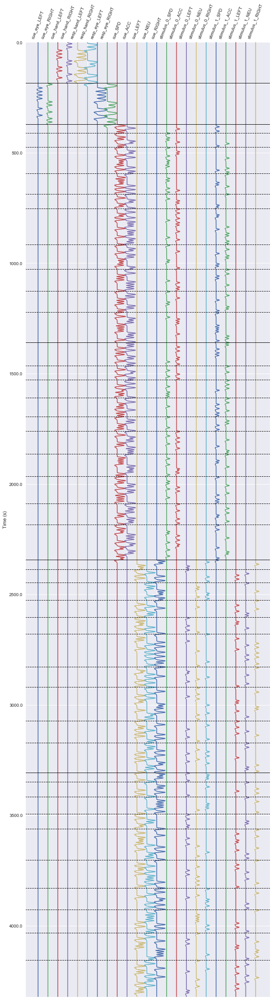

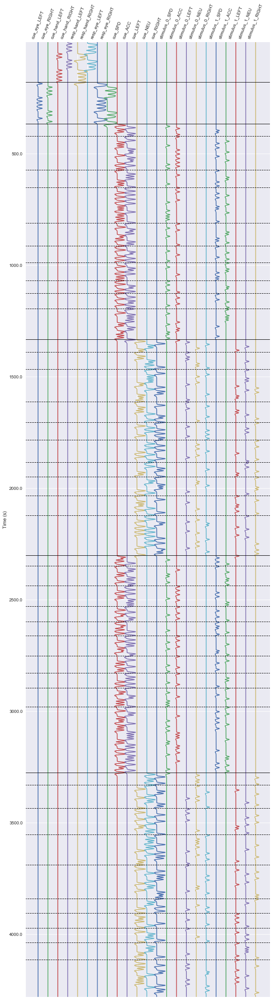

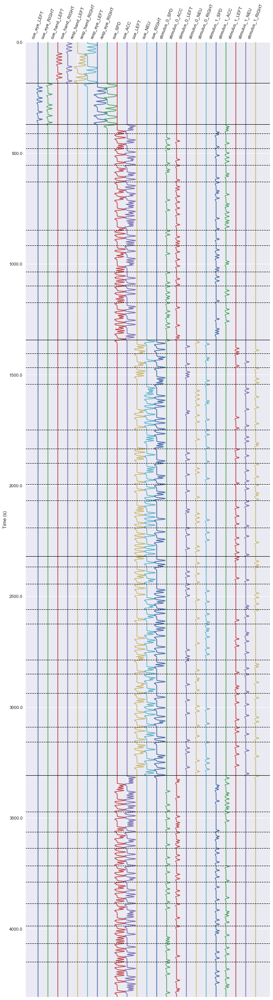

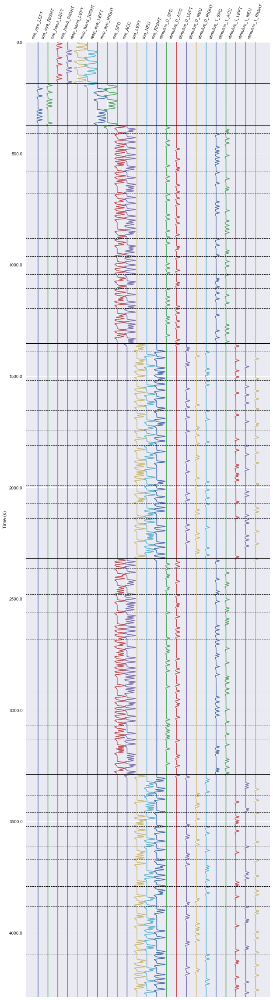

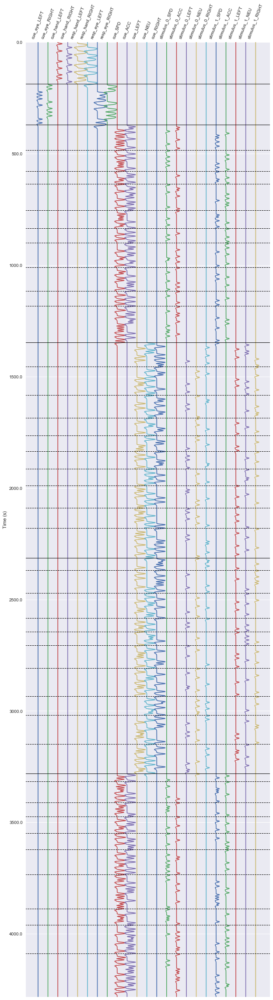

...

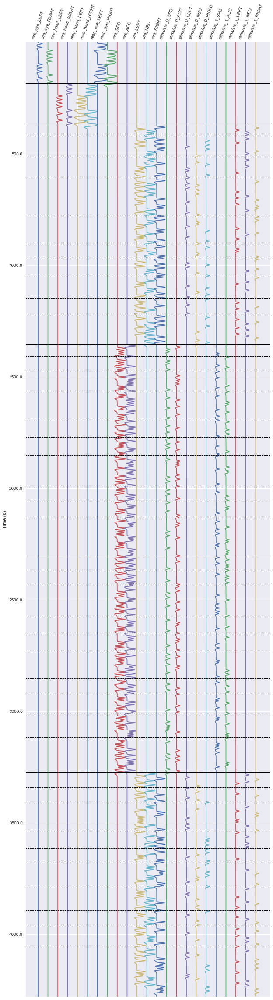

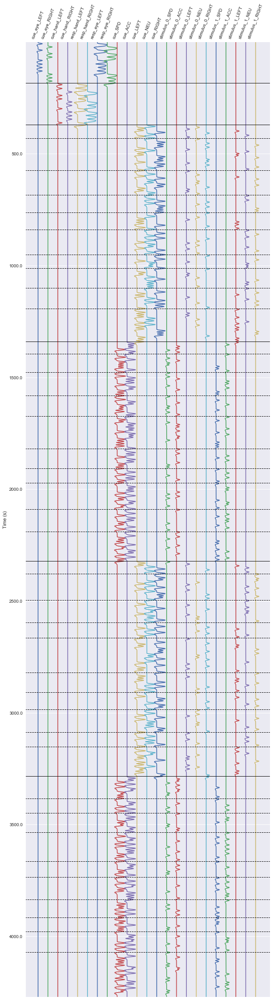

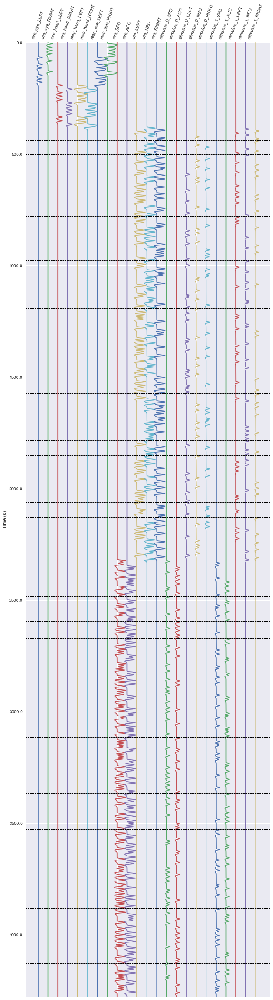

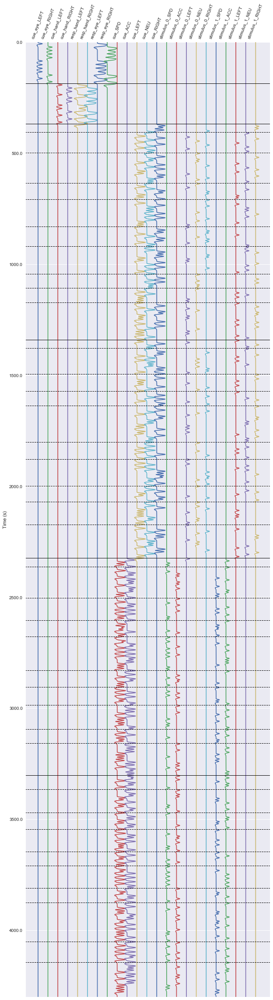

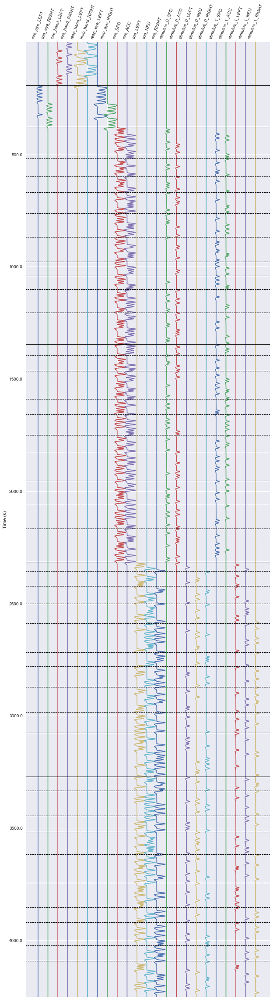

In [12]:
overwrite = True
pps = range(1, 49)

if overwrite:
    for pp in pps:
        print('Processing participant %d' % pp)
        pp_num = str(pp).zfill(3)
        pp_dir = os.path.join('pp_%s' % pp_num, 'all_blocks')
        
        design_this_pp = pd.read_csv(os.path.join(pp_dir, 'trials.csv'))
        design_this_pp = design_this_pp[['trial_type', 'correct_answer','response_modality', 'block_trial_ID', 'block', 'phase_2', 'phase_4', 'cue', 'cue_onset_time', 'stimulus_onset_time', 'trial_start_time', 'null_trial']]

        plot_participant_design(design_this_pp, pp)

## Evaluating the design matrix
Plot correlation matrix first

In [17]:
# Select pp num and load design
pp_num = 1
pp_str = str(1).zfill(3)
pp_dir = os.path.join('pp_%s' % pp_str, 'all_blocks', 'trials.csv')
pp_design = pd.read_csv(pp_dir) # Load design

# Calculate design matrix
X, ev_names = stim_to_design(pp_design)
print(X.shape)
print(ev_names)
X = np.hstack((np.ones(shape=(X.shape[0], 1)), X))  # Add column of ones to design matrix? for 'event' in general/baseline?

Convolving cue_hand_LEFT...
Convolving cue_hand_RIGHT...
Convolving cue_eye_LEFT...
Convolving cue_eye_RIGHT...
Convolving resp_hand_LEFT...
Convolving resp_hand_RIGHT...
Convolving resp_eye_LEFT...
Convolving resp_eye_RIGHT...
Convolving cue_SPD...
Convolving cue_ACC...
Convolving cue_RIGHT...
Convolving cue_LEFT...
Convolving cue_NEU...
Convolving stimulus_1_SPD...
Convolving stimulus_1_ACC...
Convolving stimulus_1_RIGHT...
Convolving stimulus_1_LEFT...
Convolving stimulus_1_NEU...
Convolving stimulus_0_SPD...
Convolving stimulus_0_ACC...
Convolving stimulus_0_RIGHT...
Convolving stimulus_0_LEFT...
Convolving stimulus_0_NEU...
(43223, 23)
['cue_hand_LEFT', 'cue_hand_RIGHT', 'cue_eye_LEFT', 'cue_eye_RIGHT', 'resp_hand_LEFT', 'resp_hand_RIGHT', 'resp_eye_LEFT', 'resp_eye_RIGHT', 'cue_SPD', 'cue_ACC', 'cue_RIGHT', 'cue_LEFT', 'cue_NEU', 'stimulus_1_SPD', 'stimulus_1_ACC', 'stimulus_1_RIGHT', 'stimulus_1_LEFT', 'stimulus_1_NEU', 'stimulus_0_SPD', 'stimulus_0_ACC', 'stimulus_0_RIGHT', 'st

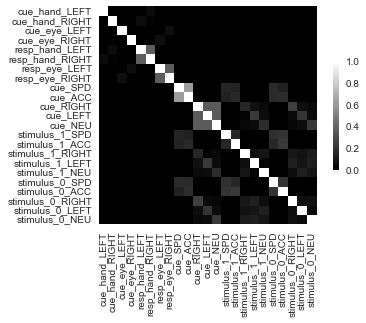

In [18]:
# Calculate correlation matrix
df = pd.DataFrame(X[:,1:], columns=ev_names).corr()
corr = np.abs(df).corr()

# Plot
sns.heatmap(corr, vmax=1, vmin=0, center=.5, cmap='gray',
            square=True, linewidths=0.00, cbar_kws={"shrink": .5})

## Calculate efficiency